In [1]:
from __future__ import absolute_import
from __future__ import division
from __future__ import print_function

%matplotlib inline
import matplotlib.pyplot as plt

from PIL import Image
from matplotlib.pyplot import imshow
import matplotlib.cm as cm

import numpy as np

import skimage.transform
from scipy import ndimage
import scipy.misc

def image_show(image_path):
  imshow(np.asarray(Image.open(image_path, 'r')))
  plt.axis('off')
  plt.show()

import tensorflow as tf
flags = tf.app.flags
import gflags
flags = gflags
FLAGS = flags.FLAGS

#flags.DEFINE_string('model_dir', '/home/gezi/new/temp/image-caption/ai-challenger/model/showattentell.finetune/', '')
  
import sys, os, math
import gezi, melt
import numpy as np

from deepiu.util import algos_factory
from deepiu.seq2seq.rnn_decoder import SeqDecodeMethod

#debug
from deepiu.util import text2ids

TEXT_MAX_WORDS = 100    
decode_max_words = 20


from deepiu.util import ids2text
vocab_path = '/home/gezi/new/temp/image-caption/ai-challenger/tfrecord/seq-basic-finetune/vocab.txt'
ids2text.init(vocab_path)

image_dir = image_dir = '/home/gezi/data2/data/ai_challenger/image_caption/pic/'
image_file = '6275b5349168ac3fab6a493c509301d023cf39d3.jpg'
image_path = os.path.join(image_dir, image_file)
image_checkpoint_file = '/home/gezi/data/image_model_check_point/inception_v4.ckpt'
net = melt.image.get_imagenet_from_checkpoint(image_checkpoint_file)
print('image net', net, 'net.default_image_size', net.default_image_size)
FLAGS.image_model_name = FLAGS.image_model_name or net.name
FLAGS.image_height = FLAGS.image_height or net.default_image_size
FLAGS.image_width = FLAGS.image_width or net.default_image_size
image_model_name = FLAGS.image_model_name
print('image_model_name', image_model_name)

#model_dir = '/home/gezi/new/temp/image-caption/ai-challenger/model/showattentell2.finetune/'
model_dir = '/home/gezi/new/temp/image-caption/ai-challenger/model.v4/showattentell.coverage.inceptionV4.finetune/epoch/model.ckpt-23.80-780878'
#model_dir = '/home/gezi/new/temp/image-caption/ai-challenger/model.v4/showattentell.coverage.keywords'
#FLAGS.model_dir = model_dir

if not melt.varname_in_checkpoint(image_model_name, model_dir):
  image_model = melt.image.ImageModel(image_model_checkpoint_path)
else:
  image_model = None

print('image_model', image_model)

import libpinyin
pinyin = libpinyin.Pinyin()
pinyin.Load('./data/pinyin/')

tensorflow_version: 1.5.0-dev20171205
ERROR:root:Trying to access flag num_reserved_ids before flags were parsed.
Traceback (most recent call last):
  File "/usr/local/lib/python2.7/dist-packages/gflags/flagvalues.py", line 535, in __getattr__
    raise exceptions.UnparsedFlagAccessError(error_message)
UnparsedFlagAccessError: Trying to access flag num_reserved_ids before flags were parsed.
ERROR:root:Trying to access flag num_reserved_ids before flags were parsed.
Traceback (most recent call last):
  File "/usr/local/lib/python2.7/dist-packages/gflags/flagvalues.py", line 535, in __getattr__
    raise exceptions.UnparsedFlagAccessError(error_message)
UnparsedFlagAccessError: Trying to access flag num_reserved_ids before flags were parsed.


INFO:tensorflow:Initializing vocabulary from file: /home/gezi/new/temp/image-caption/ai-challenger/tfrecord/seq-basic-finetune/vocab.txt


INFO:tensorflow:Initializing vocabulary from file: /home/gezi/new/temp/image-caption/ai-challenger/tfrecord/seq-basic-finetune/vocab.txt


INFO:tensorflow:Created vocabulary with 10148 words


INFO:tensorflow:Created vocabulary with 10148 words
ERROR:root:Trying to access flag vocab_size before flags were parsed.
Traceback (most recent call last):
  File "/usr/local/lib/python2.7/dist-packages/gflags/flagvalues.py", line 535, in __getattr__
    raise exceptions.UnparsedFlagAccessError(error_message)
UnparsedFlagAccessError: Trying to access flag vocab_size before flags were parsed.
ERROR:root:Trying to access flag num_reserved_ids before flags were parsed.
Traceback (most recent call last):
  File "/usr/local/lib/python2.7/dist-packages/gflags/flagvalues.py", line 535, in __getattr__
    raise exceptions.UnparsedFlagAccessError(error_message)
UnparsedFlagAccessError: Trying to access flag num_reserved_ids before flags were parsed.
ENCODE_UNK 1
ERROR:root:Trying to access flag image_model_name before flags were parsed.
Traceback (most recent call last):
  File "/usr/local/lib/python2.7/dist-packages/gflags/flagvalues.py", line 535, in __getattr__
    raise exceptions.Unparsed

image net <function inception_v4 at 0x7f90a2bd8a28> net.default_image_size 299
image_model_name InceptionV4
image_model None


In [2]:
if 'coverage' in model_dir:
  FLAGS.coverage_attention_wrapper = True

FLAGS.image_encoder = 'Rnn'
FLAGS.showtell_encode_scope = 'encode'
FLAGS.showtell_decode_scope = 'decode'
FLAGS.image_endpoint_feature_name = 'attention'
FLAGS.image_checkpoint_file = image_checkpoint_file
FLAGS.pre_calc_image_feature = False
FLAGS.finetune_image_model = True 
FLAGS.image_features_batch_norm = True 
FLAGS.emb_dim = 512 
FLAGS.rnn_hidden_size = 512 
FLAGS.alignment_history = True

FLAGS.image_attention_size = FLAGS.image_attention_size or melt.image.get_num_features(FLAGS.image_model_name)
FLAGS.image_feature_len = FLAGS.image_feature_len or melt.image.get_feature_dim(FLAGS.image_model_name) * FLAGS.image_attention_size

beam_size = 10
length_normalization_factor = 0.25

ERROR:root:Trying to access flag image_attention_size before flags were parsed.
Traceback (most recent call last):
  File "/usr/local/lib/python2.7/dist-packages/gflags/flagvalues.py", line 535, in __getattr__
    raise exceptions.UnparsedFlagAccessError(error_message)
UnparsedFlagAccessError: Trying to access flag image_attention_size before flags were parsed.
ERROR:root:Trying to access flag image_model_name before flags were parsed.
Traceback (most recent call last):
  File "/usr/local/lib/python2.7/dist-packages/gflags/flagvalues.py", line 535, in __getattr__
    raise exceptions.UnparsedFlagAccessError(error_message)
UnparsedFlagAccessError: Trying to access flag image_model_name before flags were parsed.
ERROR:root:Trying to access flag image_feature_len before flags were parsed.
Traceback (most recent call last):
  File "/usr/local/lib/python2.7/dist-packages/gflags/flagvalues.py", line 535, in __getattr__
    raise exceptions.UnparsedFlagAccessError(error_message)
UnparsedFlagA

In [3]:
# algo = 'show_and_tell'
# global_scope = algo
# main_scope = 'main'
# melt.apps.image_processing.init(FLAGS.image_model_name)
# with tf.variable_scope(global_scope):
#   with tf.variable_scope(main_scope):
#     predictor =  algos_factory.gen_predictor(algo)
#     predictor.init_predict_text(decode_method=SeqDecodeMethod.ingraph_beam, 
#                                 beam_size=beam_size,
#                                 length_normalization_factor=length_normalization_factor,
#                                 logprobs_history=True,
#                                 alignment_history=True)  

# predictor.load(FLAGS.model_dir) 

In [4]:
predictor = melt.Predictor(model_dir)

class Predictor(object):
  def __init__(self, predictor):
    self._predictor = predictor
    self._sess = sess = predictor.sess
    self._graph = graph = predictor.graph
    self._ops = [graph.get_collection(x)[-1] for x in ['beam_text', 'beam_text_score', 'beam_logprobs_history', 'beam_alignment_history']]
  def predict_text(self, feature):
    return self._sess.run(self._ops, feed_dict={self._graph.get_collection('feed')[-1]: feature})
  
predictor = Predictor(predictor)

load frozen graph from /home/gezi/new/temp/image-caption/ai-challenger/model.v4/showattentell.coverage.inceptionV4.finetune/epoch/model.ckpt-23.80-780878.pb with mapfile /home/gezi/new/temp/image-caption/ai-challenger/model.v4/showattentell.coverage.inceptionV4.finetune/epoch/model.ckpt-23.80-780878.map start


Instructions for updating:
Please file an issue at https://github.com/tensorflow/tensorflow/issues if you depend on this feature.


Instructions for updating:
Please file an issue at https://github.com/tensorflow/tensorflow/issues if you depend on this feature.
load frozen graph from /home/gezi/new/temp/image-caption/ai-challenger/model.v4/showattentell.coverage.inceptionV4.finetune/epoch/model.ckpt-23.80-780878.pb with mapfile /home/gezi/new/temp/image-caption/ai-challenger/model.v4/showattentell.coverage.inceptionV4.finetune/epoch/model.ckpt-23.80-780878.map duration: 11.2101111412


In [5]:
def simple_predict(image_path, predictor):
  timer = gezi.Timer('beam search using time')
  img = melt.read_image(image_path)
  if image_model:
    #attention model gen features only
    feature = image_model.gen_features(img) if image_model is not None else img
  else:
    feature = [img]    
  #texts_list, scores_list = predictor.predict_text(feature)
  #timer.print()
  logprobs_history = None 
  alignment_history = None

  l = predictor.predict_text(feature)
  timer.print()
  texts_list, scores_list= l[0], l[1]
  try:
    logprobs_history = l[2]
    alignment_history = l[3]
  except Exception:
    pass

  #print(alignment_history)

  texts = texts_list[0]
  scores = scores_list[0]
  if logprobs_history is not None:
    logprobs = logprobs_history[0]
  else:
    logprobs = [None] * len(texts)
  if alignment_history is not None:
    alignments = alignment_history[0]
  else:
    alignments = [None] * len(texts)
    
  logprob = None 
  alignment = None 
    
  for text, score, logprob, alignment in zip(texts, scores, logprobs, alignments):
    print('align shape', alignment.shape)
    print(ids2text.ids2text(text), score)
    print(text, len(text))
    if logprob is not None:
      print(map(math.exp, logprob))
    #if alignment is not None:
    #  print(alignment)
    #  print(alignment[10], alignment[11], alignment[12])


In [6]:
#simple_predict(image_path, predictor)

In [7]:
def predict(image_path, predictor, length_normalization_factor=0.25, num_show=1):
  img = melt.read_image(image_path)
  if image_model:
    feature = image_model.gen_feature(img) if image_model is not None else img
  else:
    feature = [img]

  timer = gezi.Timer()
  texts, scores, logprobs_history, alignment_history = predictor.predict_text(feature)
  for i, (text, score, logprob, alignment) in enumerate(zip(texts[0], scores[0], logprobs_history[0], alignment_history[0])):
    print(ids2text.ids2text(text), score)

    # Plot images with attention weights
    words = ids2text.ids2words(text) 
    img = ndimage.imread(image_path)
    
    num_features = melt.image.get_num_features(image_model_name)
    dim = int(np.sqrt(num_features))
    #print('dim:', dim)

    n_words = len(words)
    n_words += 1 #for ori image
    w = np.round(np.sqrt(n_words))
    h = np.ceil(np.float32(n_words) / w)
    
    #print(n_words, w, h)
    IMAGE_SIZE = (14, 10)
    plt.figure(figsize=IMAGE_SIZE)
    plt.subplot(w, h, 1)
    plt.imshow(img)
    plt.axis('off')

    #img = scipy.misc.imresize(img, (dim, dim))  

    #smooth = True  #TODO smooth = Ture seems not work not back ground pic
    smooth = False
    if i < 10:  
      #print('probs', [math.exp(x) for x in logprob])
      for j in range(len(words)):
        #if i == 0:
        #  print(i, j, words[j], alignment[j])
        plt.subplot(w, h, j + 2)
        lab = pinyin.Convert(words[j].decode('utf8').encode('gbk'))
        lab += '(%0.2f)'%math.exp(logprob[j])
        plt.text(0, 1, lab, backgroundcolor='white', fontsize=10)
        plt.text(0, 1, lab, color='black', fontsize=10)
        plt.imshow(img)
        if smooth:
          alpha_img = skimage.transform.pyramid_expand(alignment[j].reshape(dim, dim), upscale=16, sigma=20)
        else:
          alpha_img = skimage.transform.resize(alignment[j].reshape(dim, dim), [img.shape[0], img.shape[1]])
        plt.imshow(alpha_img, alpha=0.8)
        plt.set_cmap(cm.Greys_r)
        plt.axis('off')
      plt.show()
      #plt.savefig('test%d.pdf'%i)

    print('beam search using time(ms):', timer.elapsed_ms())

In [ ]:
%%html
<style>
.output_wrapper, .output {
    height:auto !important;
    max-height:10000px;  /* your desired max-height here */
}
.output_scroll {
    box-shadow:none !important;
    webkit-box-shadow:none !important;
}
</style>

image_name like 6275b5349168ac3fab6a493c509301d023cf39d3.jpg: 0151c1c75a0cbc9ca5a5bcf99bd02939b3cb7580


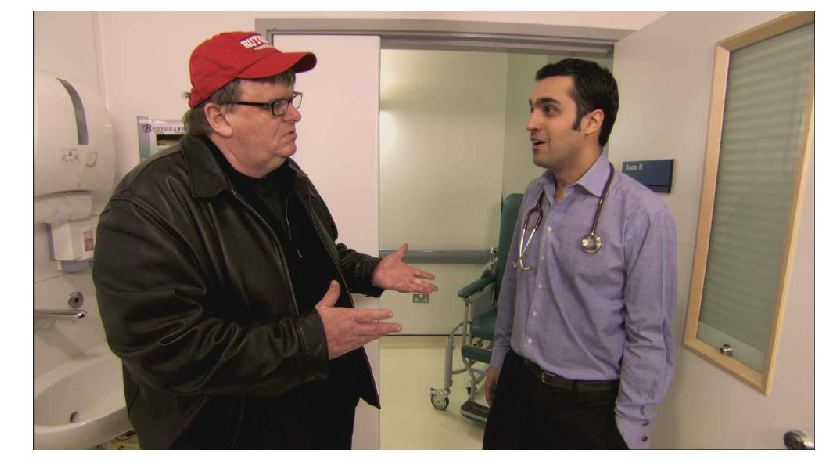

屋子里 有 一个 戴着 帽子 的 男人 和 一个 戴着 帽子 的 男人 在 交谈 </S> 0.0321006


/usr/local/lib/python2.7/dist-packages/skimage/transform/_warps.py:84: UserWarning: The default mode, 'constant', will be changed to 'reflect' in skimage 0.15.
  warn("The default mode, 'constant', will be changed to 'reflect' in "


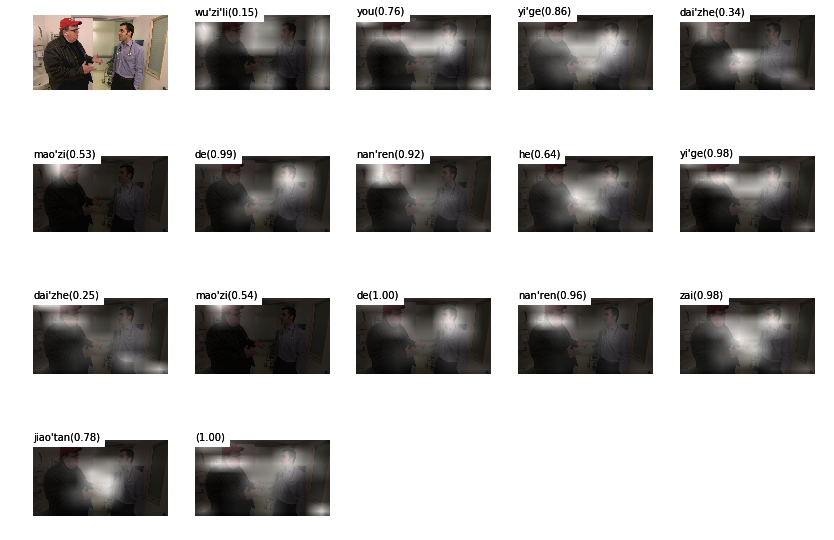

beam search using time(ms): 5906.71396255
房间 里 有 一个 戴着 帽子 的 男人 和 一个 戴着 帽子 的 男人 在 交谈 </S> 0.0311432


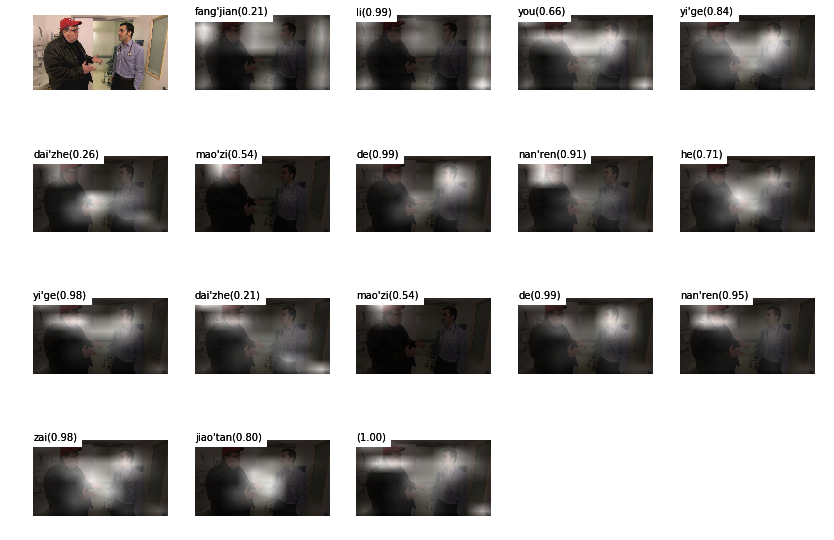

beam search using time(ms): 1647.13406563
一个 戴着 帽子 的 男人 和 一个 戴着 帽子 的 男人 在 房间 里 交谈 </S> 0.0302378


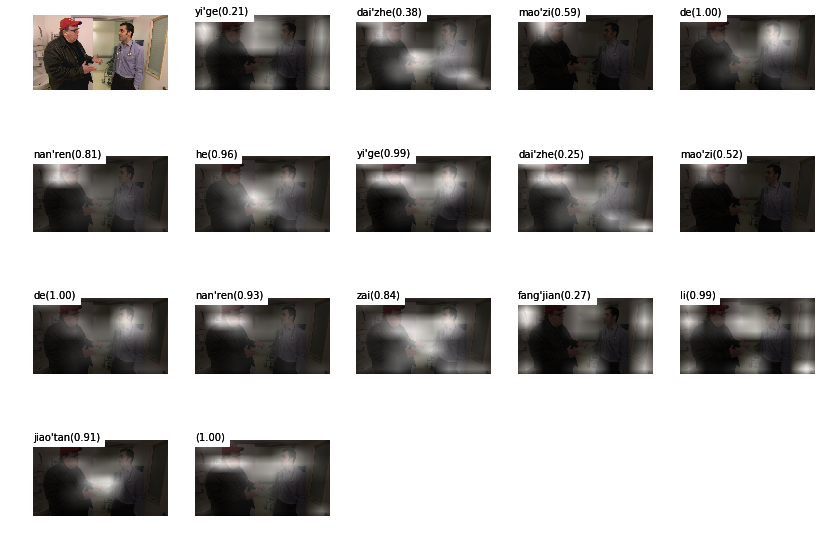

beam search using time(ms): 1569.82898712
房间 里 有 一个 左手 抬起 的 男人 和 一个 戴着 帽子 的 男人 在 交谈 </S> 0.026068


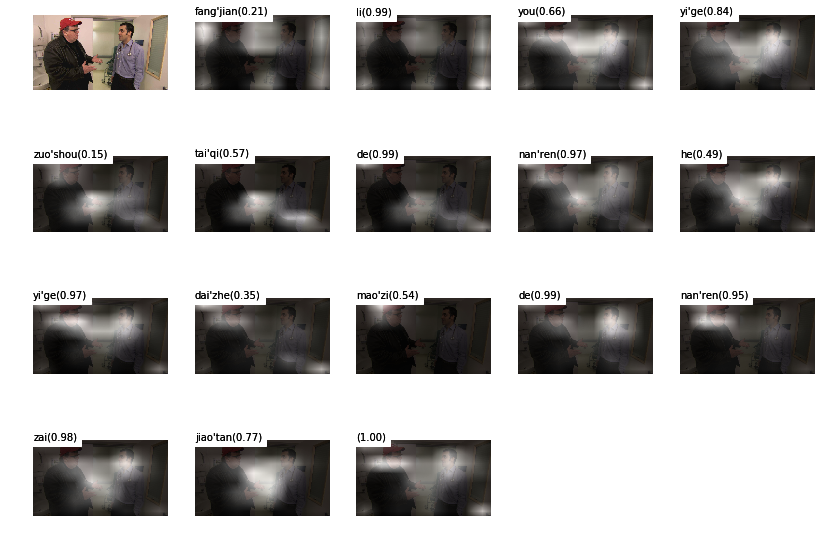

beam search using time(ms): 1657.09590912
房间 里 有 一个 戴着 帽子 的 男人 和 一个 右手 抬起 的 男人 在 交谈 </S> 0.02448


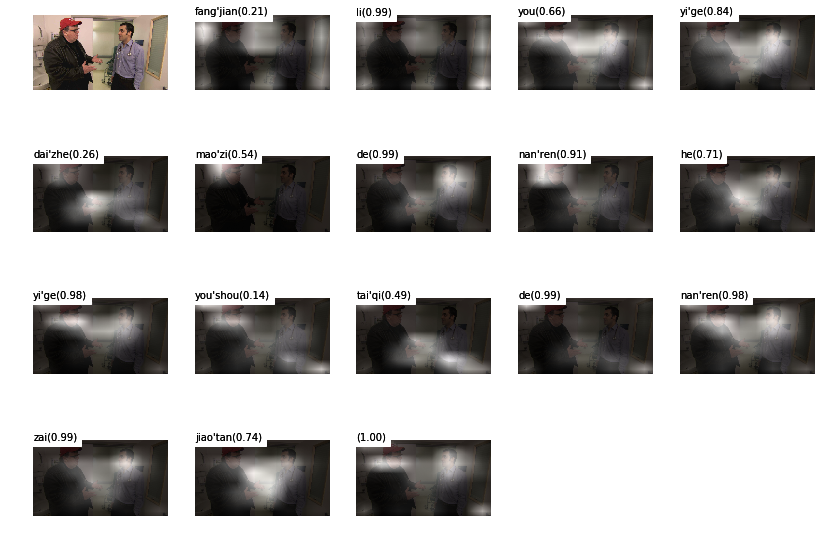

beam search using time(ms): 1656.71300888
房间 里 有 一个 戴着 帽子 的 男人 和 一个 戴着 眼镜 的 男人 在 交谈 </S> 0.024084


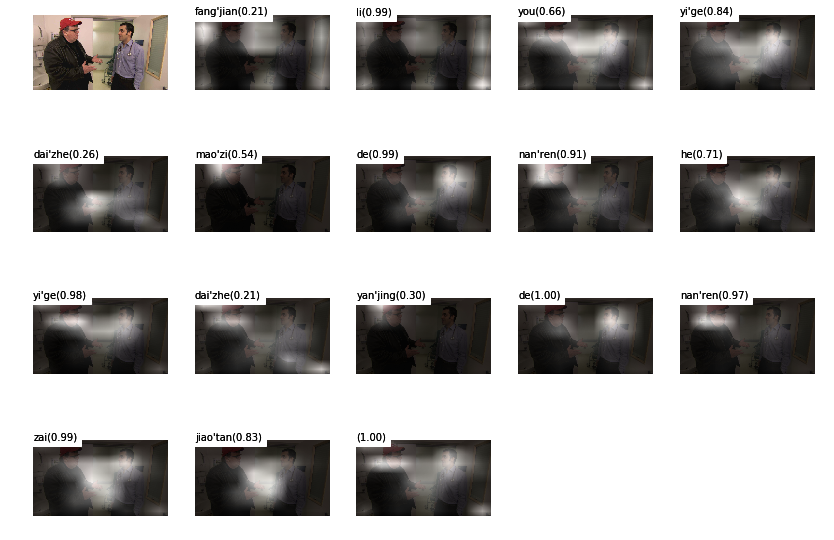

beam search using time(ms): 1651.36599541
一个 戴着 帽子 的 男人 和 一个 戴着 帽子 的 男人 在 屋子里 交谈 </S> 0.0217166


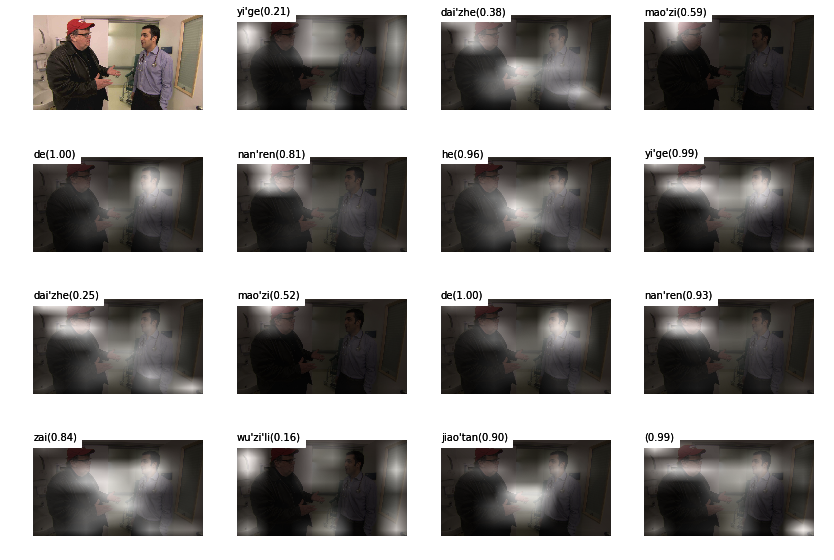

beam search using time(ms): 1567.19303131
一个 戴着 帽子 的 男人 和 一个 戴着 帽子 的 男人 在 室内 交谈 </S> 0.021341


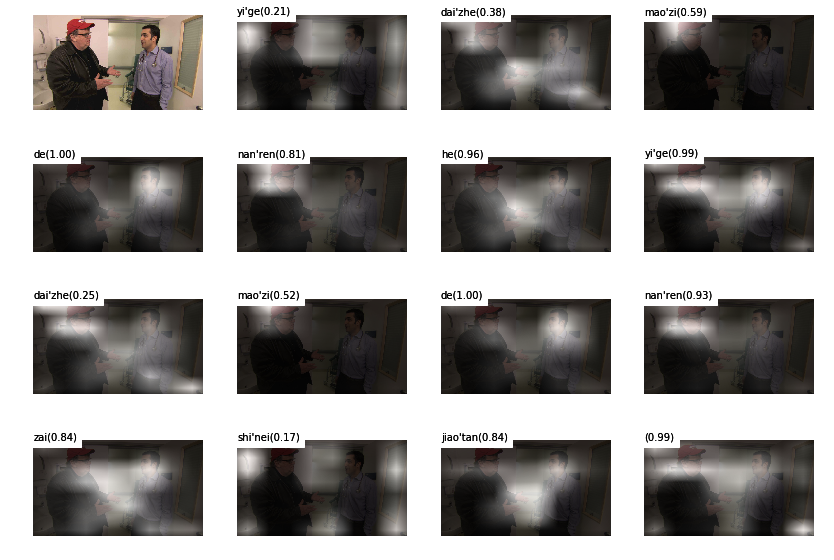

beam search using time(ms): 1567.15703011
房间 里 有 一个 左手 抬起 的 男人 在 和 一个 戴着 眼镜 的 男人 说话 </S> 0.0167415


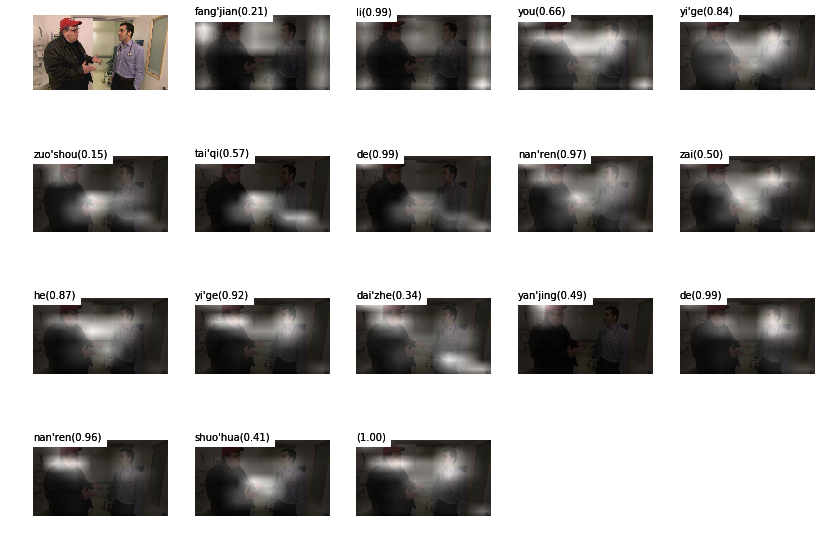

beam search using time(ms): 1652.50897408
房间 里 有 一个 左手 抬起 的 男人 在 和 一个 戴着 眼镜 的 男人 交谈 </S> 0.0154018


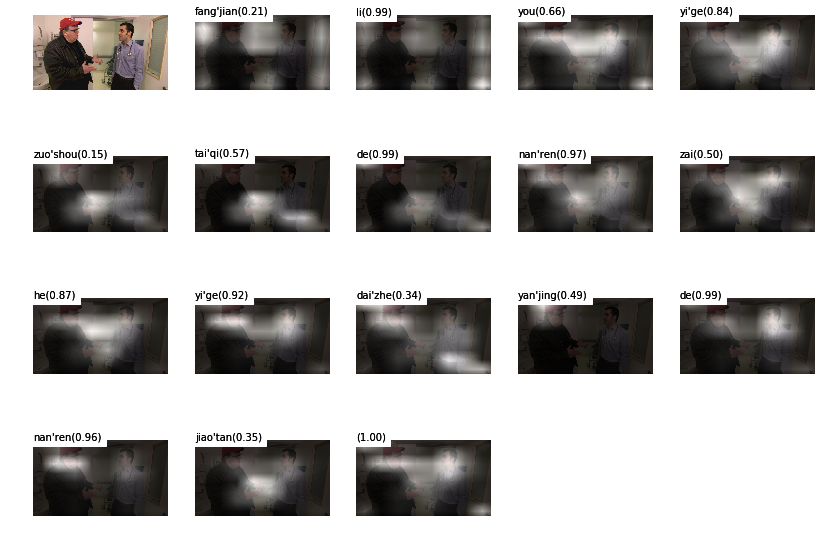

beam search using time(ms): 2208.68802071
image_name like 6275b5349168ac3fab6a493c509301d023cf39d3.jpg: bc2797404d29cfd70d2b8f3bc1072f21e4acc797


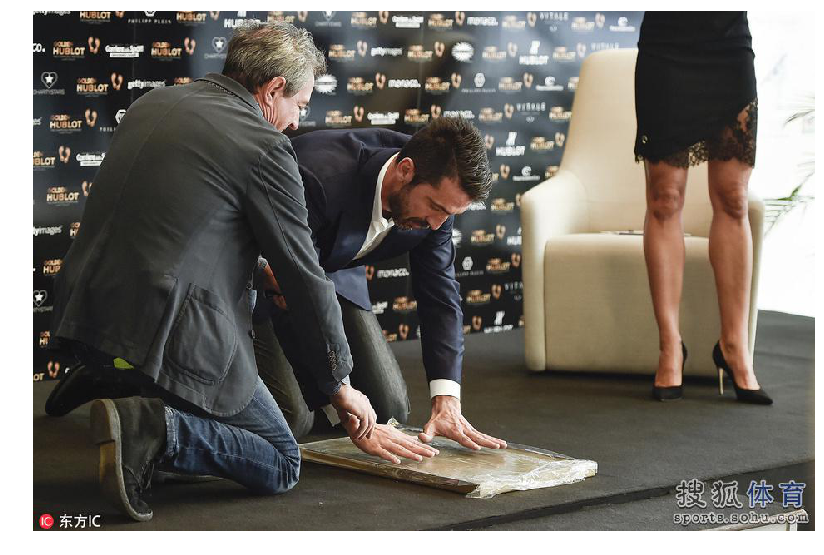

室内 一个 人 的 前面 有 一个 穿着 西装 的 男人 在 按 手印 </S> 0.0294083


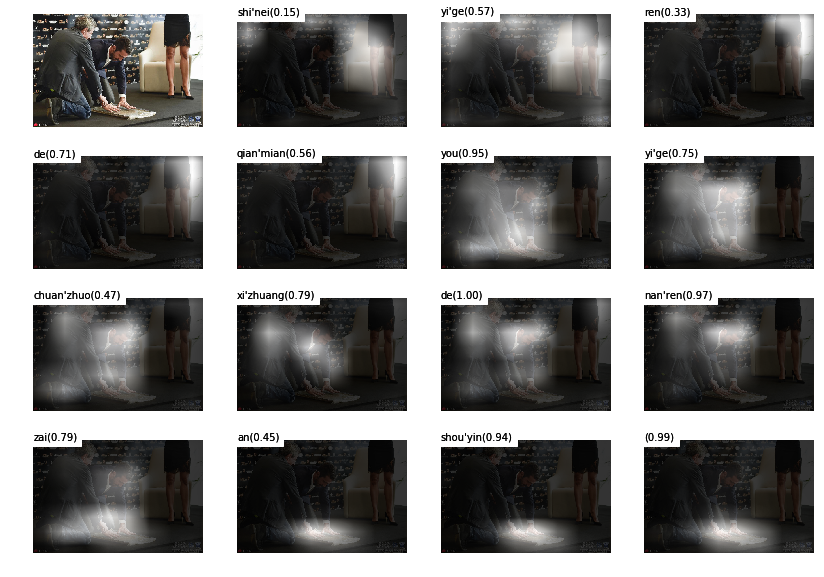

beam search using time(ms): 2272.93205261
大厅 里 两个 人 的 旁边 有 一个 穿着 西装 的 男人 在 按 手印 </S> 0.028415


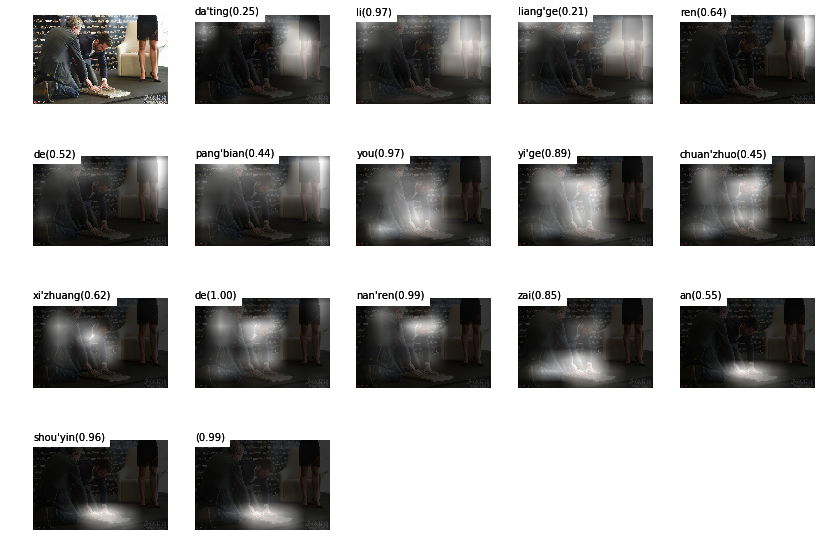

beam search using time(ms): 1619.71998215
大厅 里 两个 人 的 前面 有 一个 穿着 西装 的 男人 在 按 手印 </S> 0.0260302


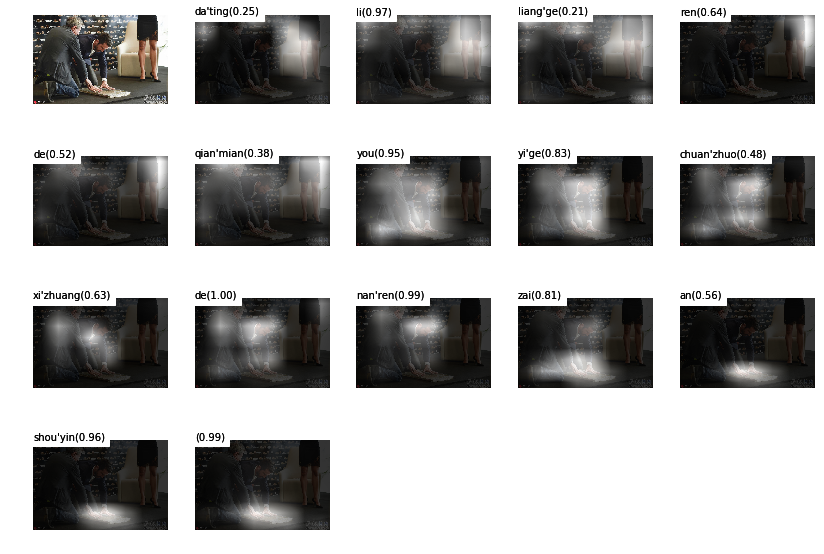

beam search using time(ms): 1590.73400497
大厅 里 一个 人 的 前面 有 一个 穿着 西装 的 男人 在 按 手印 </S> 0.0235308


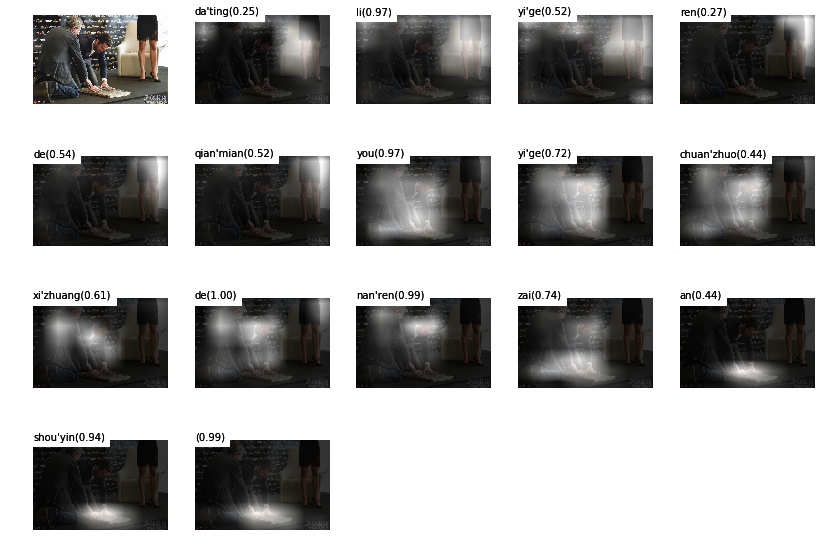

beam search using time(ms): 1588.09280396
大厅 里 一个 女人 的 前面 有 一个 穿着 西装 的 男人 在 按 手印 </S> 0.0207307


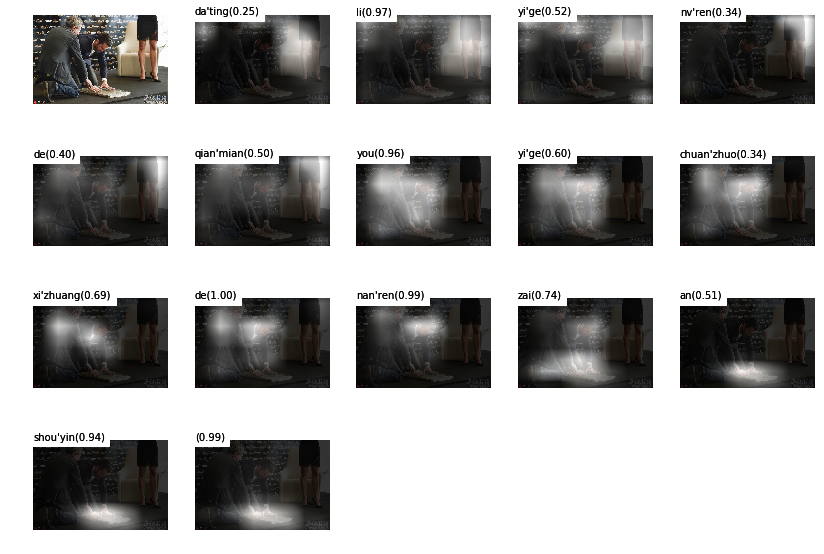

beam search using time(ms): 1584.22112465
大厅 里 一个 女人 的 旁边 有 一个 穿着 西装 的 男人 在 按 手印 </S> 0.0206512


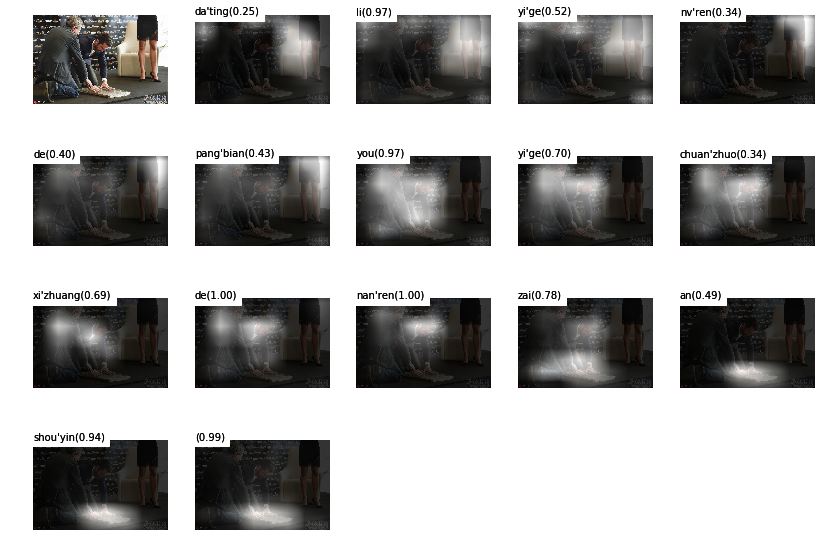

beam search using time(ms): 1582.71598816
大厅 里 一个 人 的 旁边 有 一个 穿着 西装 的 男人 在 按 手印 </S> 0.0202318


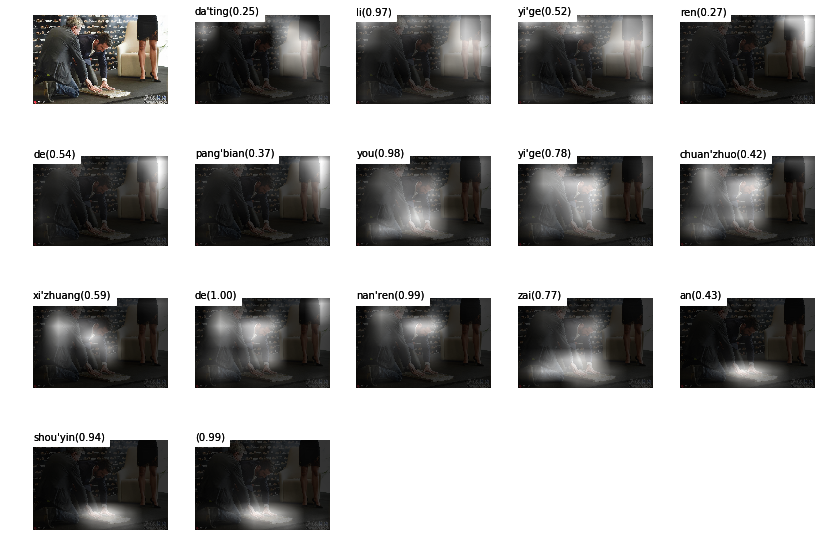

beam search using time(ms): 1588.89889717
大厅 里 一个 女人 的 前面 有 一个 弯着腰 的 男人 在 按 手印 </S> 0.0170692


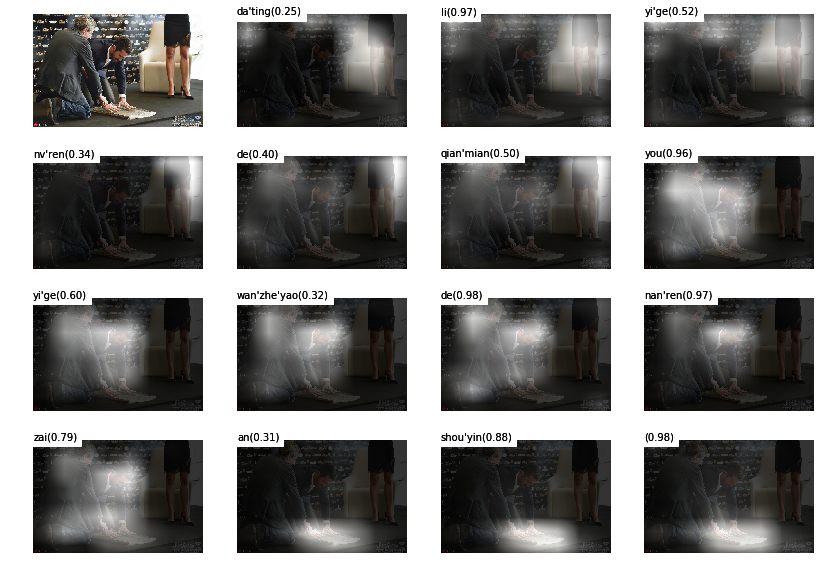

beam search using time(ms): 1707.74912834
大厅 里 一个 女人 的 旁边 有 一个 弯着腰 的 男人 在 按 手印 </S> 0.0166272


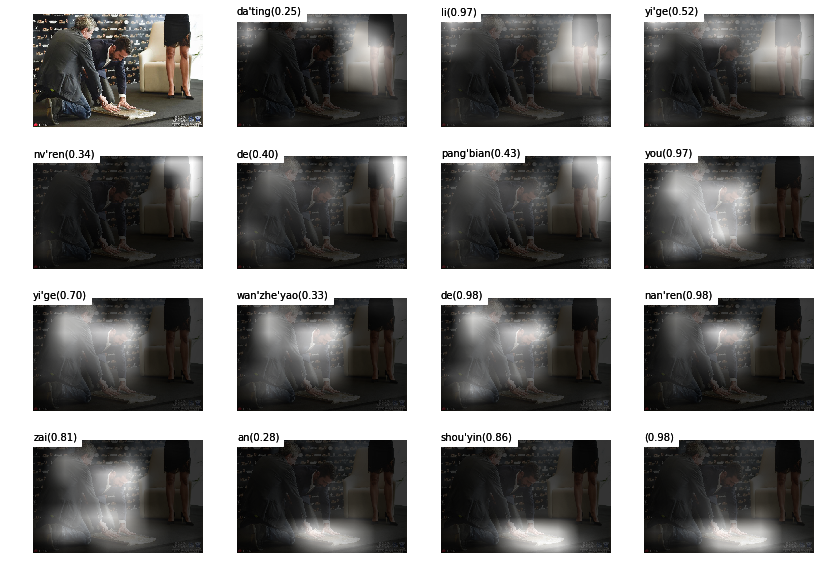

beam search using time(ms): 1721.24099731
两个 人 的 旁边 有 一个 穿着 西装 的 男人 在 大厅 里 按 手印 </S> 0.0127891


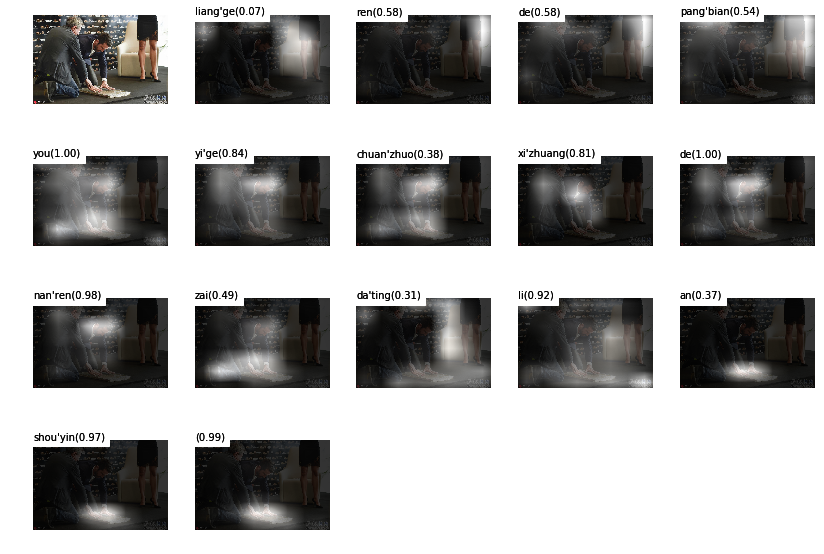

beam search using time(ms): 2257.35092163
image_name like 6275b5349168ac3fab6a493c509301d023cf39d3.jpg: ecbf7a275ac0ea9ecf462b76f0e832251581493b	


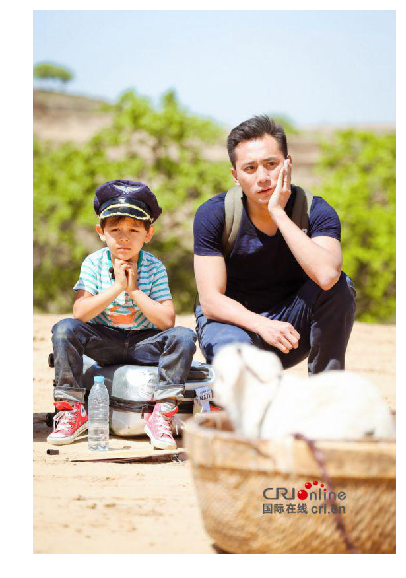

室外 一个 蹲 着 的 男人 旁有 一个 戴着 帽子 的 孩子 坐在 行李箱 上 </S> 0.0143673


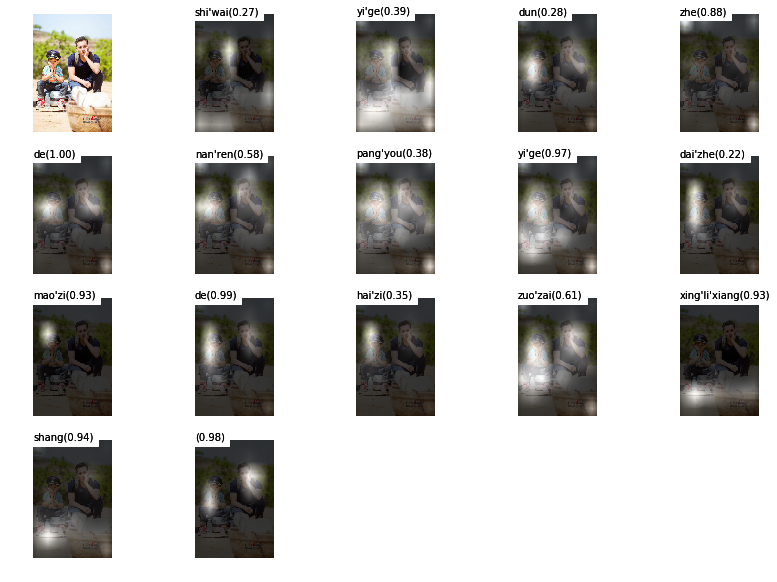

beam search using time(ms): 2126.96504593
室外 一个 蹲 着 的 男人 旁有 一个 戴着 帽子 的 男孩 坐在 行李箱 上 </S> 0.0138331


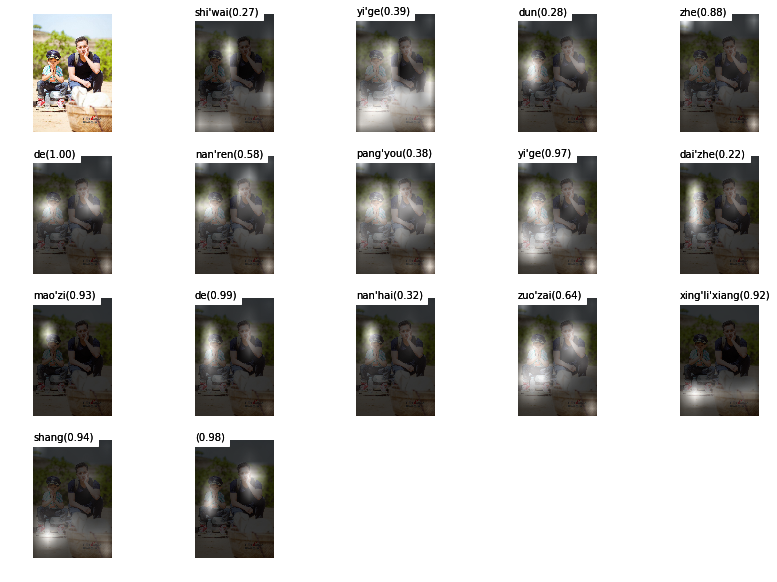

beam search using time(ms): 1411.82303429
室外 一个 蹲 着 的 男人 旁有 一个 戴着 帽子 的 小孩 坐在 行李箱 上 </S> 0.0127784


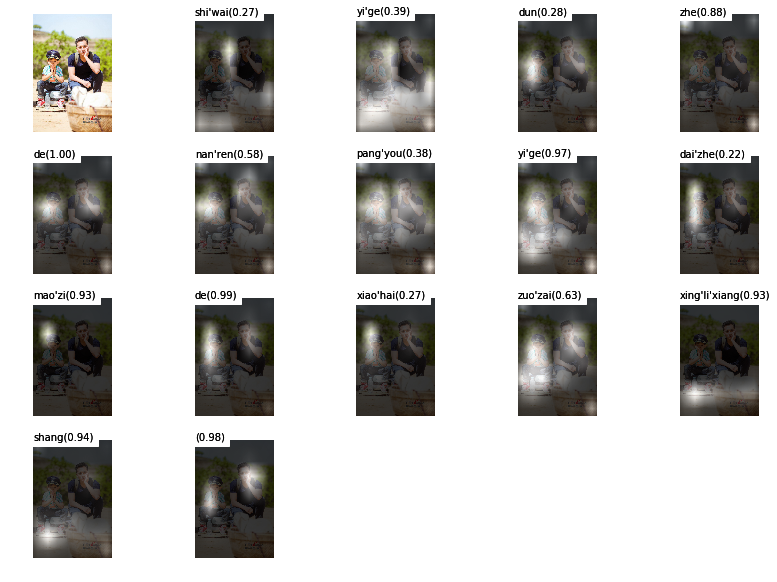

beam search using time(ms): 1410.16888618
室外 的 空地 上 一个 蹲 着 的 男孩 旁边 蹲 着 一个 左手 托着 下巴 的 男人 </S> 0.0100937


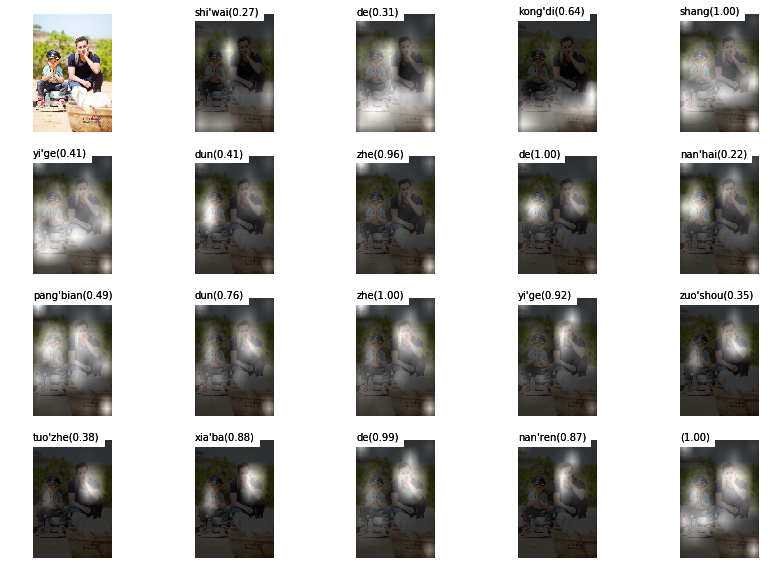

beam search using time(ms): 1623.1739521
道路 上 一个 蹲 着 的 男人 旁有 一个 戴着 帽子 的 孩子 坐在 行李箱 上 </S> 0.00973924


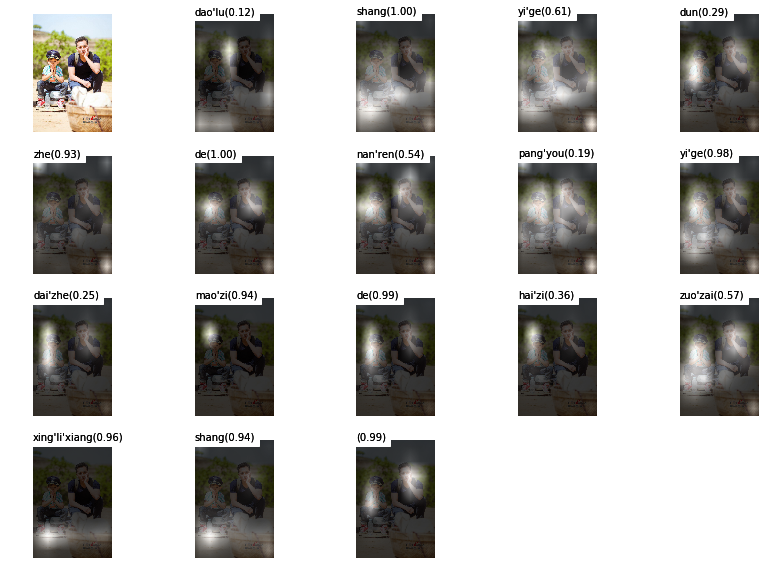

beam search using time(ms): 1457.85903931
室外 的 空地 上 一个 蹲 着 的 男孩 旁边 蹲 着 一个 右手 托着 下巴 的 男人 </S> 0.0094742


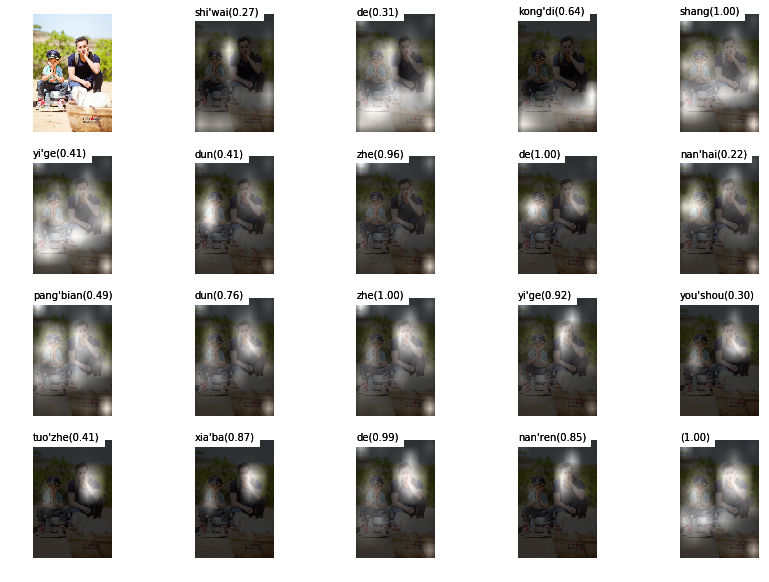

beam search using time(ms): 1614.20607567
室外 的 空地 上 一个 蹲 着 的 男人 旁边 蹲 着 一个 双手 托着 下巴 的 男孩 </S> 0.00778232


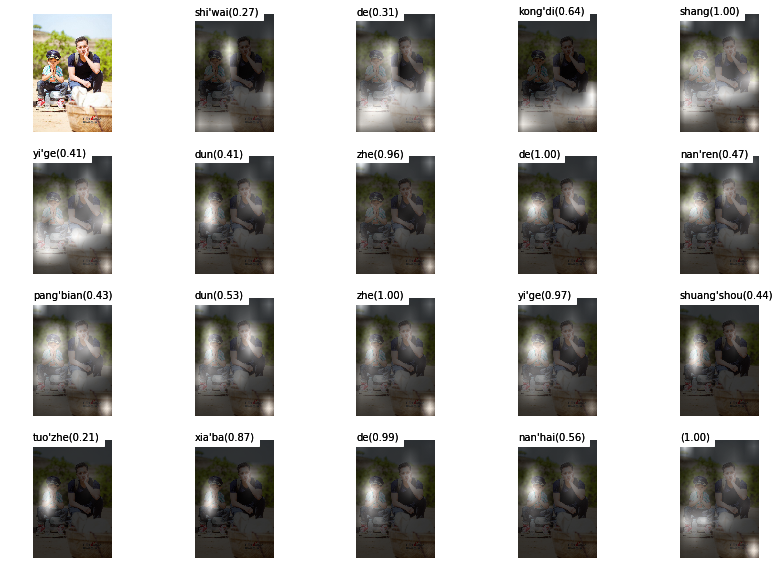

beam search using time(ms): 1617.60687828
室外 的 空地 上 一个 蹲 着 的 男人 旁边 蹲 着 一个 戴着 帽子 的 男孩 </S> 0.00628273


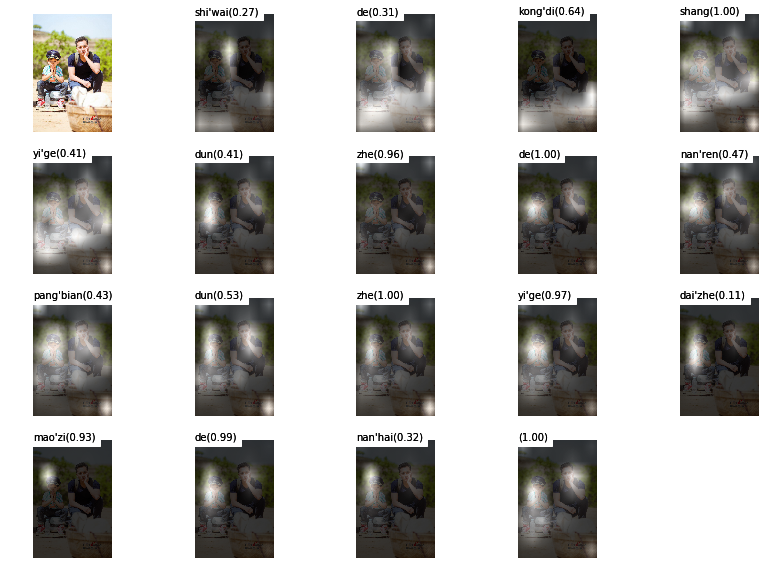

beam search using time(ms): 1535.54415703
室外 的 空地 上 一个 蹲 着 的 男人 旁边 蹲 着 一个 双手 托 腮 的 男孩 </S> 0.00605848


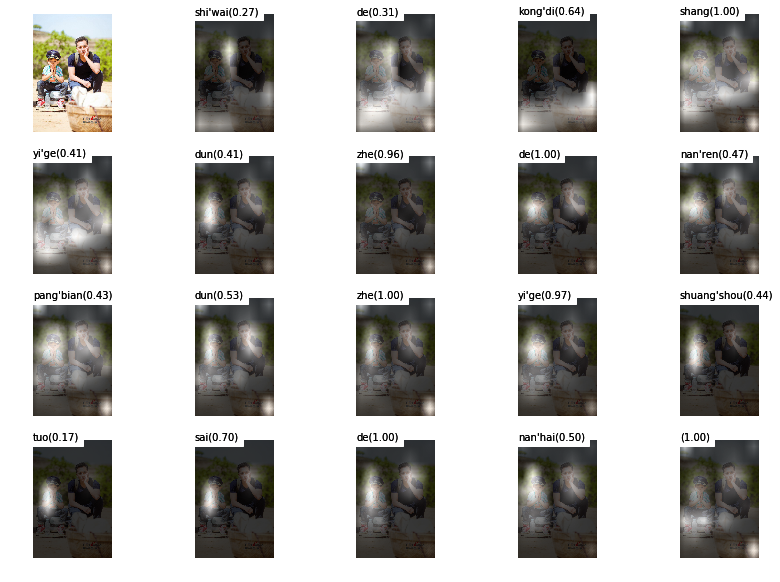

beam search using time(ms): 1618.05486679
室外 的 空地 上 一个 蹲 着 的 男人 旁边 蹲 着 一个 戴着 帽子 的 孩子 </S> 0.00597759


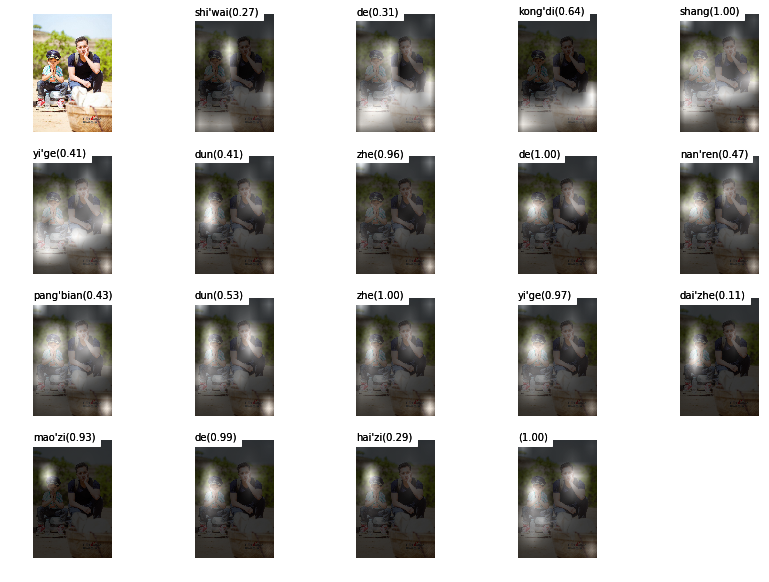

beam search using time(ms): 2109.07316208
image_name like 6275b5349168ac3fab6a493c509301d023cf39d3.jpg: 5d6d8d52590866a98e3c72fa3f5a7ee7ea9c9681


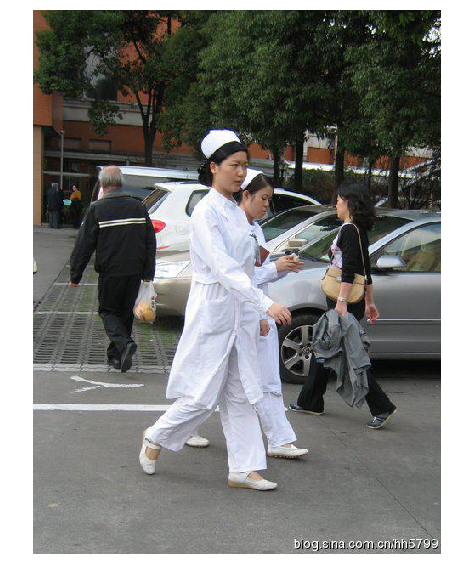

三个 人旁 有 一个 戴着 帽子 的 女人 走 在 道路 上 </S> 0.0259352


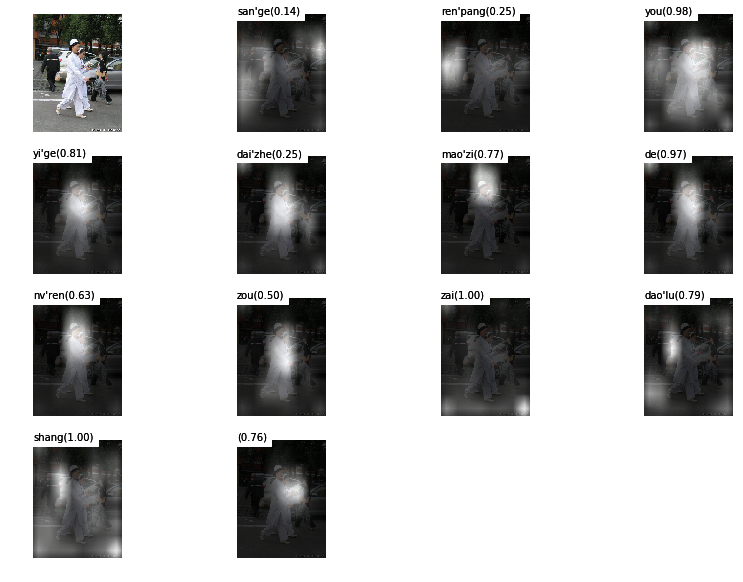

beam search using time(ms): 1589.60199356
三个 人 的 旁边 有 一个 戴着 帽子 的 女人 走 在 道路 上 </S> 0.025458


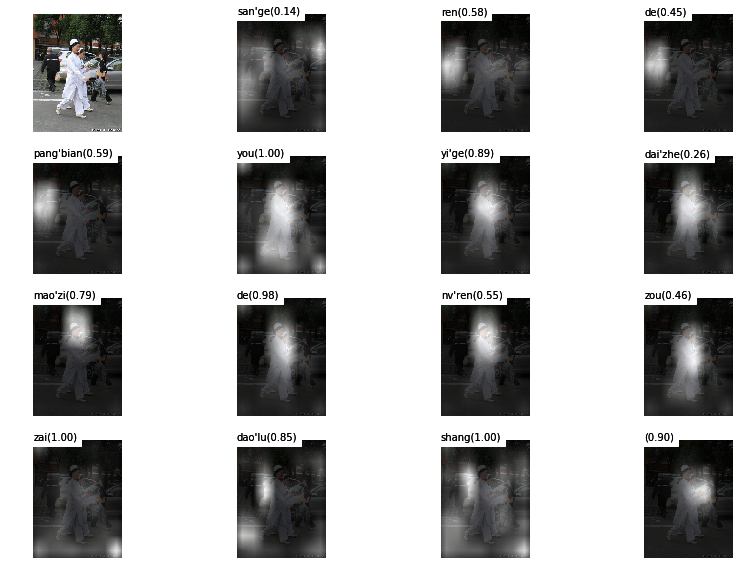

beam search using time(ms): 1147.47405052
平坦 的 街道 上 两个 人旁 走 着 一位 戴着 帽子 的 女士 </S> 0.0201301


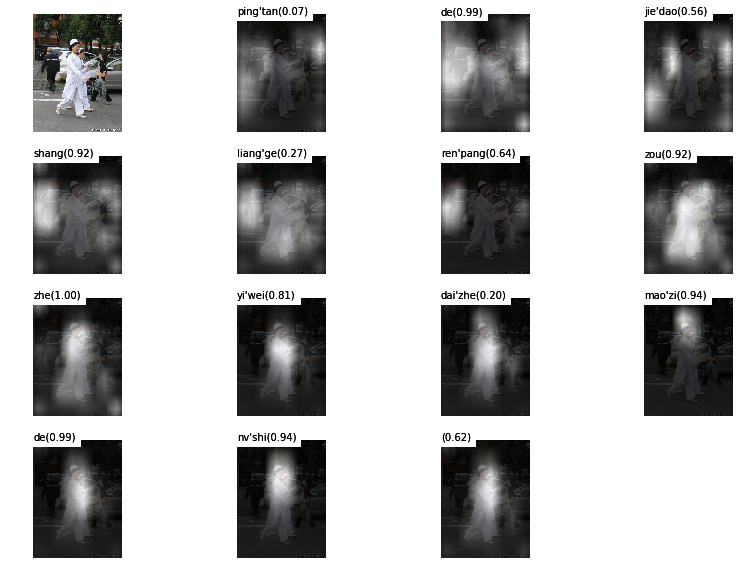

beam search using time(ms): 1077.24905014
平坦 的 街道 上 两个 人旁 走 着 一位 穿着 白色 衣服 的 女士 </S> 0.0186207


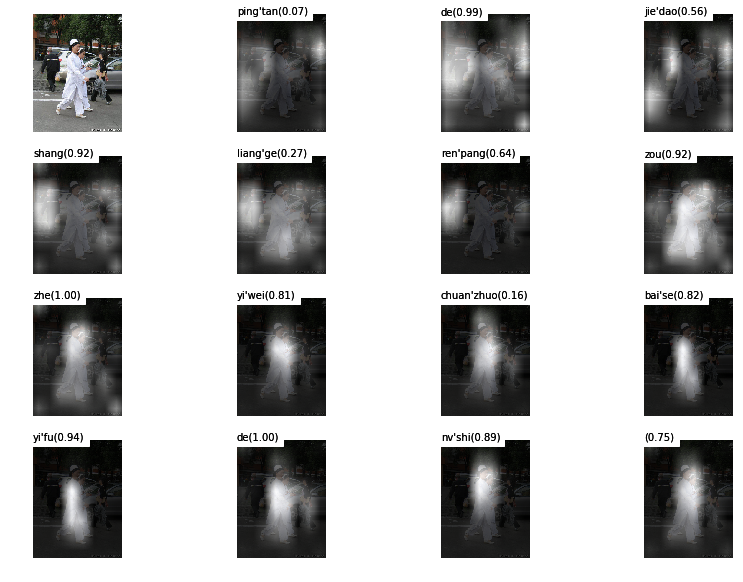

beam search using time(ms): 1149.33300018
平坦 的 街道 上 两个 人旁 走 着 一位 右手 拿 着 东西 的 女士 </S> 0.0168937


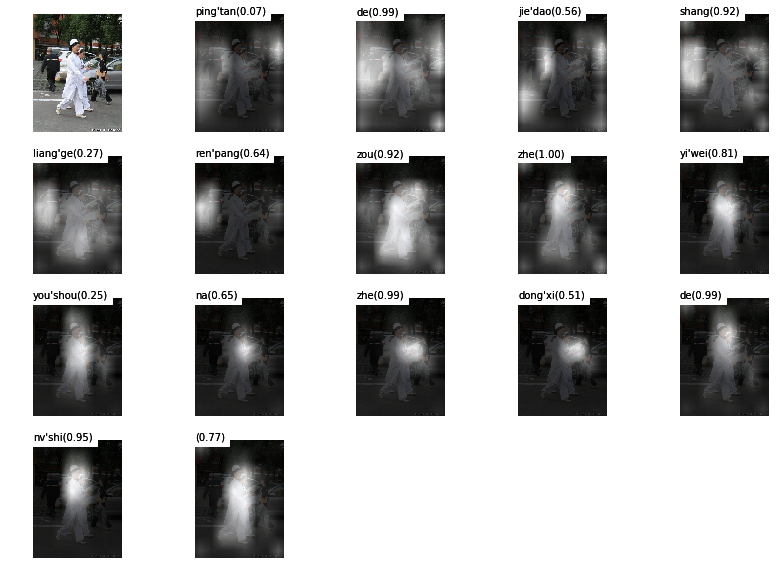

beam search using time(ms): 1220.71695328
三个 人旁 有 一个 戴着 帽子 的 女人 走 在 道路 上 的 汽车 旁 </S> 0.0158866


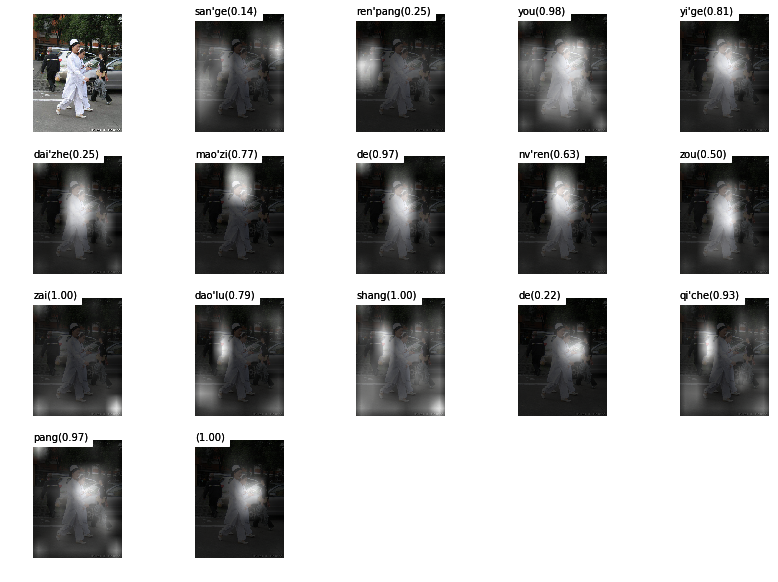

beam search using time(ms): 1221.06790543
三个 人 的 旁边 有 一个 穿着 白色 衣服 的 女人 走 在 道路 上 </S> 0.0153256


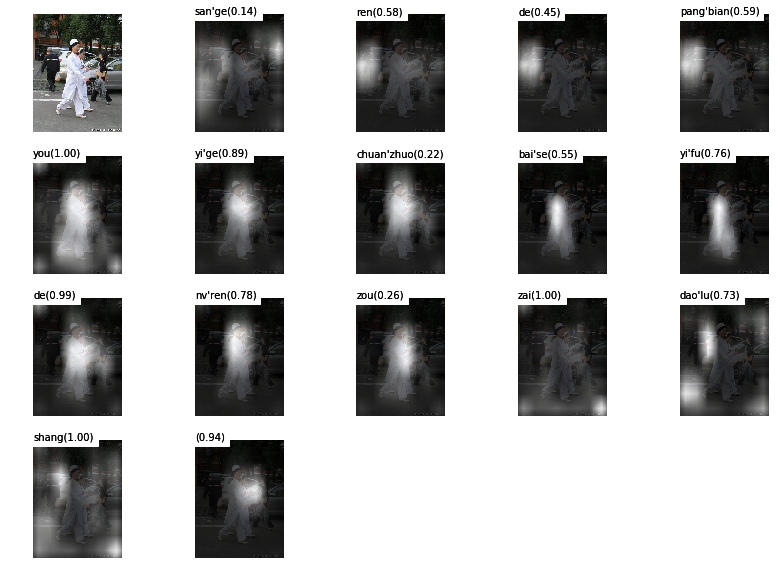

beam search using time(ms): 1216.74704552
道路 上 两个 人 的 后面 走 着 两个 穿着 白色 衣服 的 女人 </S> 0.0146562


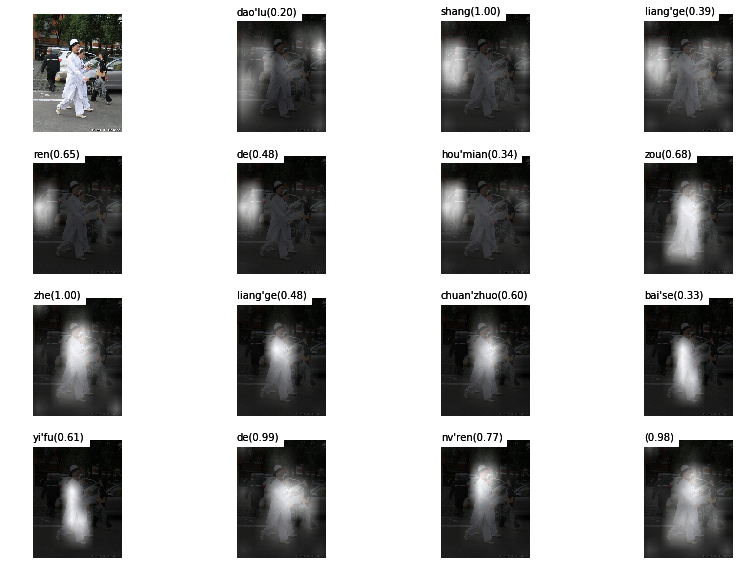

beam search using time(ms): 1143.64004135
三个 人 的 旁边 有 一个 戴着 帽子 的 女人 走 在 道路 上 的 汽车 旁 </S> 0.00919716


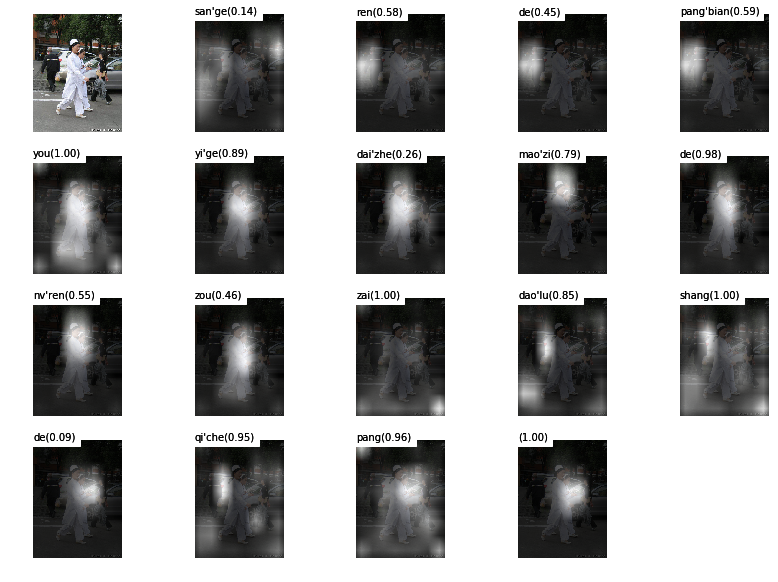

beam search using time(ms): 1362.05887794
平坦 的 街道 上 两个 人旁 走 着 一位 戴着 帽子 的 女士 和 一位 斜 背着 包 的 女士 </S> 0.00678287


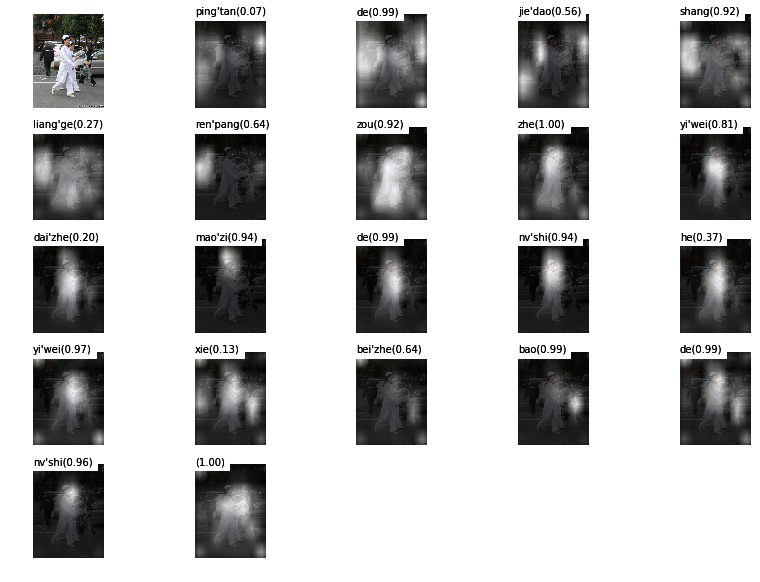

beam search using time(ms): 1493.97206306
image_name like 6275b5349168ac3fab6a493c509301d023cf39d3.jpg:  /data2/data/shijue/pic/laojiejing.jpg


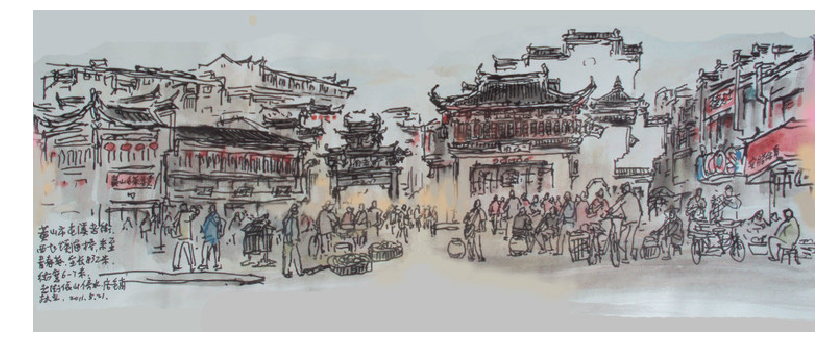

明亮 的 房间 里 站 着 一个 双手 拿 着 东西 的 男人 </S> 0.0162686


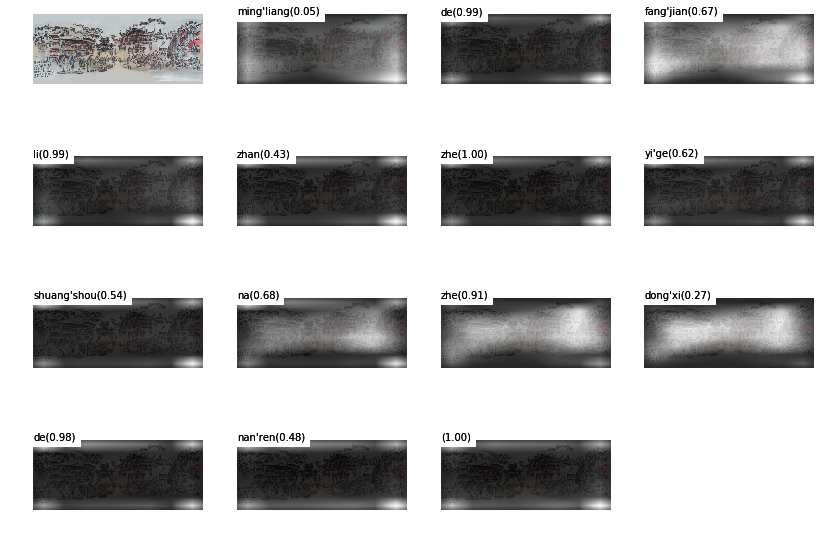

beam search using time(ms): 2660.8338356
房间 里 站 着 一个 双手 拿 着 东西 的 男人 </S> 0.015648


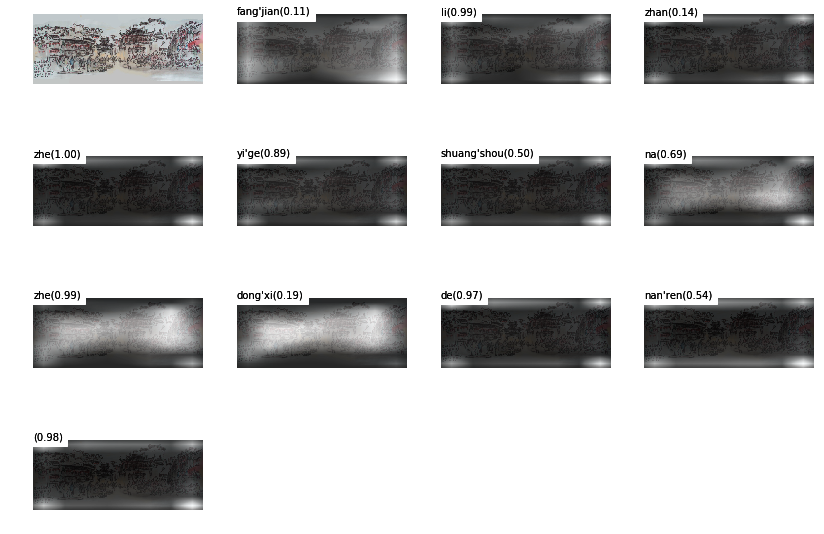

beam search using time(ms): 1086.0221386
明亮 的 房间 里 站 着 一位 双手 拿 着 东西 的 男士 </S> 0.0137856


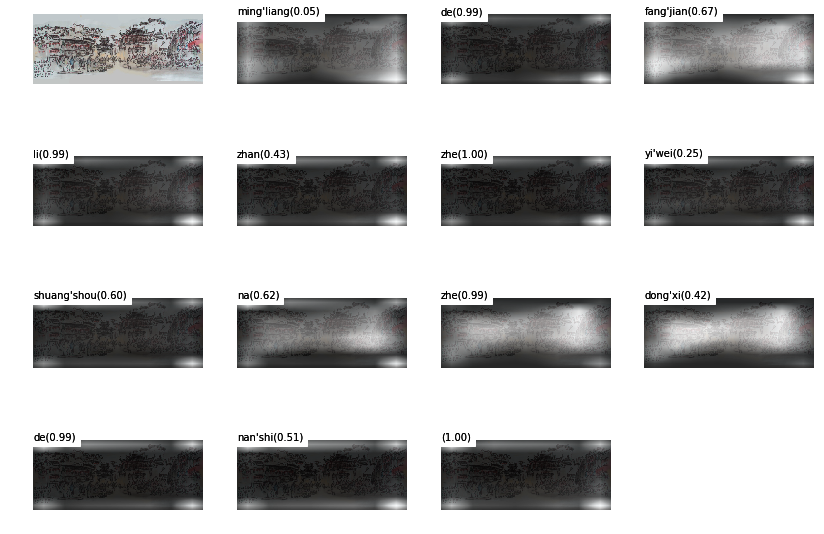

beam search using time(ms): 1331.87699318
明亮 的 房间 里 站 着 一个 双手 拿 着 东西 的 女人 </S> 0.0131973


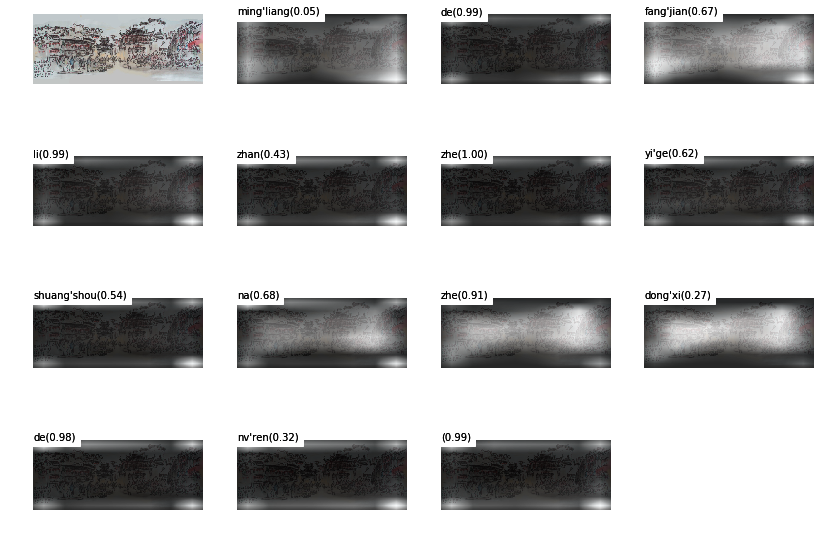

beam search using time(ms): 1315.75489044
房间 里 有 一个 右手 拿 着 笔 的 男人 在 写字 </S> 0.0117461


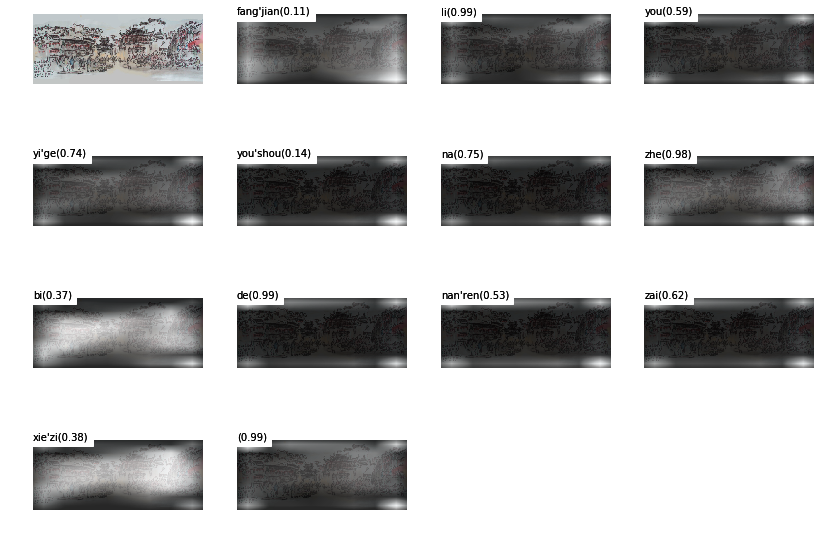

beam search using time(ms): 1186.29217148
房间 里 站 着 一个 双手 拿 着 东西 的 女人 </S> 0.0115215


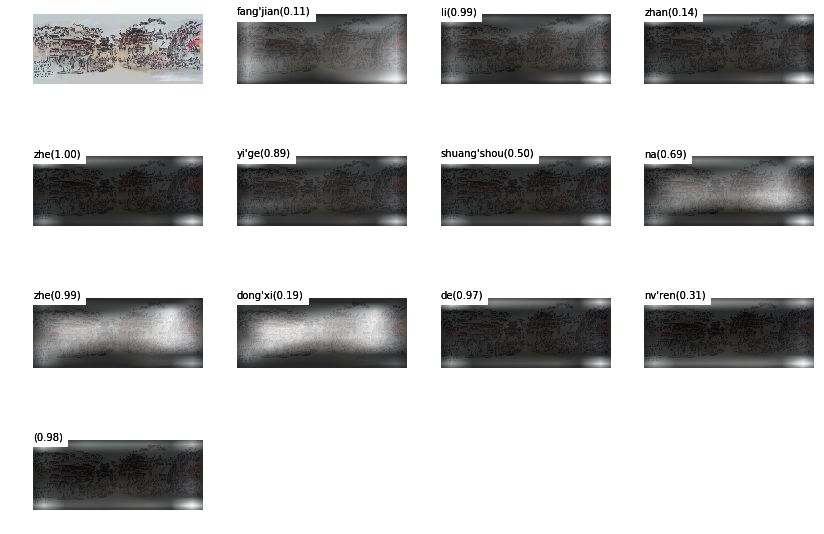

beam search using time(ms): 1171.0767746
明亮 的 房间 里 站 着 一个 双手 拿 着 纸 的 男人 </S> 0.0107475


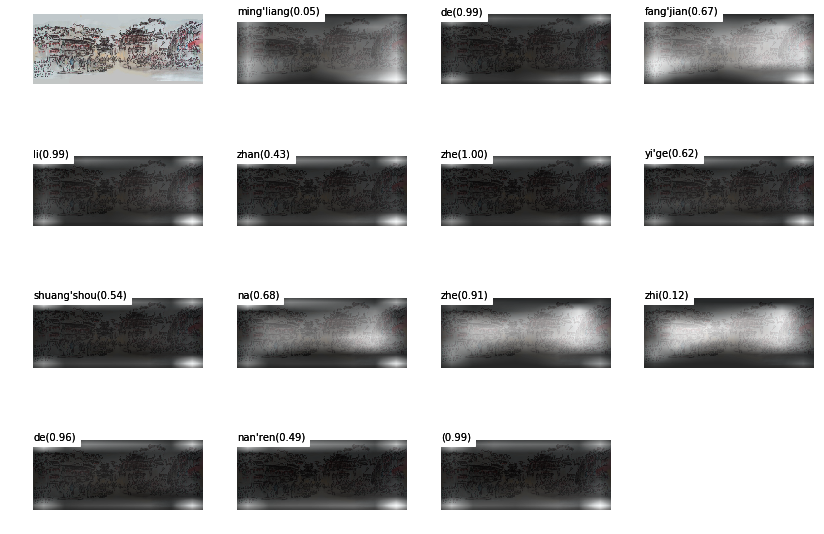

beam search using time(ms): 1339.94317055
房间 里 有 一个 右手 拿 着 毛笔 的 男人 在 写字 </S> 0.0107132


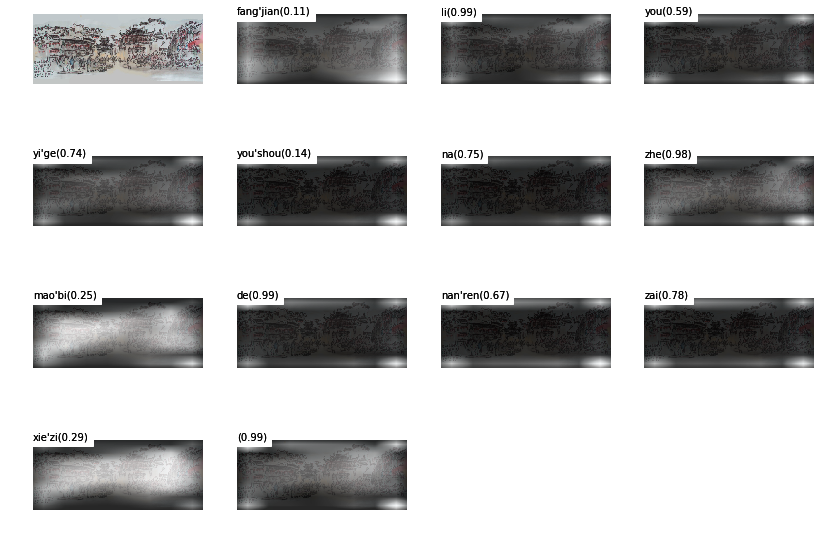

beam search using time(ms): 1277.99391747
房间 里 有 一个 右手 拿 着 笔 的 女人 在 写字 </S> 0.00908272


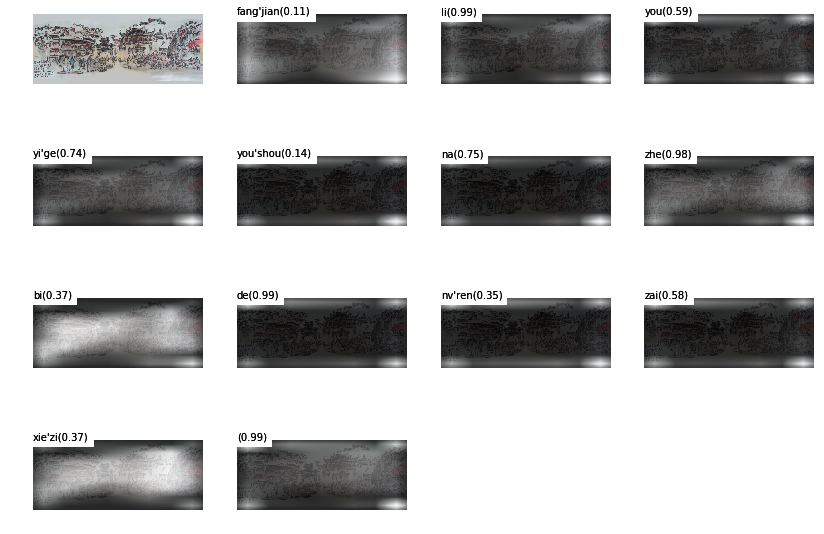

beam search using time(ms): 1115.03696442
房间 里 有 一个 右手 拿 着 毛笔 的 男人 在 画画 </S> 0.00898432


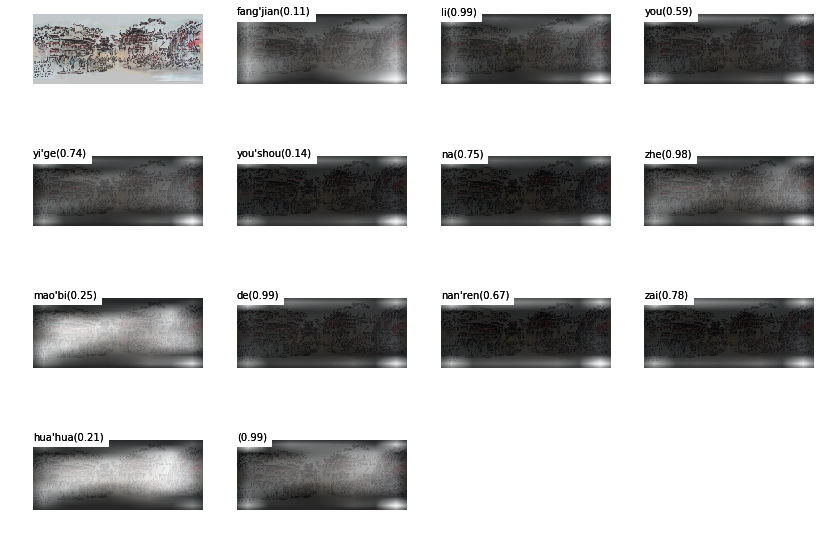

beam search using time(ms): 1228.02996635


In [ ]:
while True:
  image_name = raw_input('image_name like 6275b5349168ac3fab6a493c509301d023cf39d3.jpg: ')
  image_name = image_name.strip().replace('file://', '')
  if image_name == 'q':
    break
  if not image_name.endswith('.jpg'):
    image_name += '.jpg'

  image_path = os.path.join(image_dir, image_name)

  if not os.path.exists(image_path):
    print('path not exists:%s'%image_path)
    image_path = image_name
    if not os.path.exists(image_path):
        continue
  #plt.subplot(1, 1, 1)
  IMAGE_SIZE = (14, 10)
  plt.figure(figsize=IMAGE_SIZE)
  image_show(image_path)
  predict(image_path, predictor)
  #predict(image_path, predictor2, gen_feature=False)

In [ ]:
import glob 
for img in glob.glob('/home/gezi/new2/data/ai_challenger/image_caption/test_pic/*.jpg'):
    image_show(img)
    predict(img, predictor)